In [1]:
import torch.nn as nn
import torch
from learned_dict import TiedSAE
from util import ActivationDataset

import torchvision.transforms as transforms
import numpy as np

import umap
import matplotlib.pyplot as plt

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

activation_size = 768
n_dict_components = 10 * activation_size

encoder = torch.randn((n_dict_components, activation_size), device = device) # encoder
nn.init.xavier_uniform_(encoder)
encoder_bias = torch.zeros(n_dict_components, device = device) # encoder bias

# load trained SAE
tied_sae = TiedSAE(encoder, encoder_bias)
tied_sae.load_state_dict(torch.load('SAE_models/cifar10/SAE_ratio10_epoch100_lr1e-05.pth'))
tied_sae.to_device(device)

tied_sae.encoder.requires_grad = False
tied_sae.encoder_bias.requires_grad = False
to_tensor = transforms.ToTensor()

/ceph/kikang/miniconda3/envs/interp/lib/python3.11/site-packages/transformers/utils/hub.py:124: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(
2024-02-26 13:35:40.373980: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-26 13:35:40.374082: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-26 13:35:40.388422: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-26 13:35:54.885184: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


# Cifar10 - all layer SAE model

## original activations before encoding with SAE

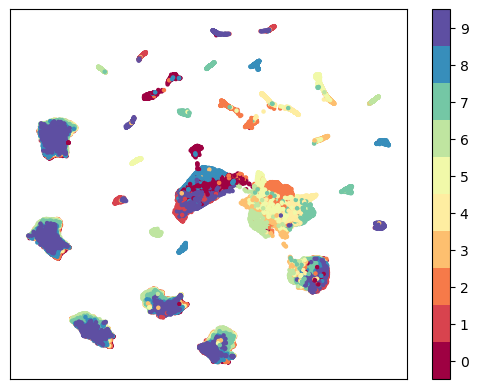

In [2]:
activations = []
labels = []

for i in range(12):
    for j in range(10):
        activation_path = f'activations_cifar10_vit_b/cifar10_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


In [3]:
reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

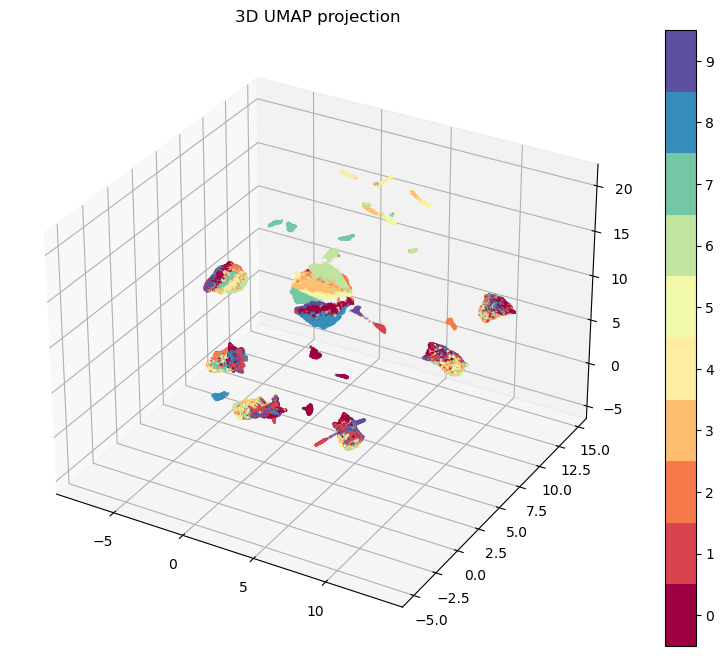

In [4]:
#3d plot

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

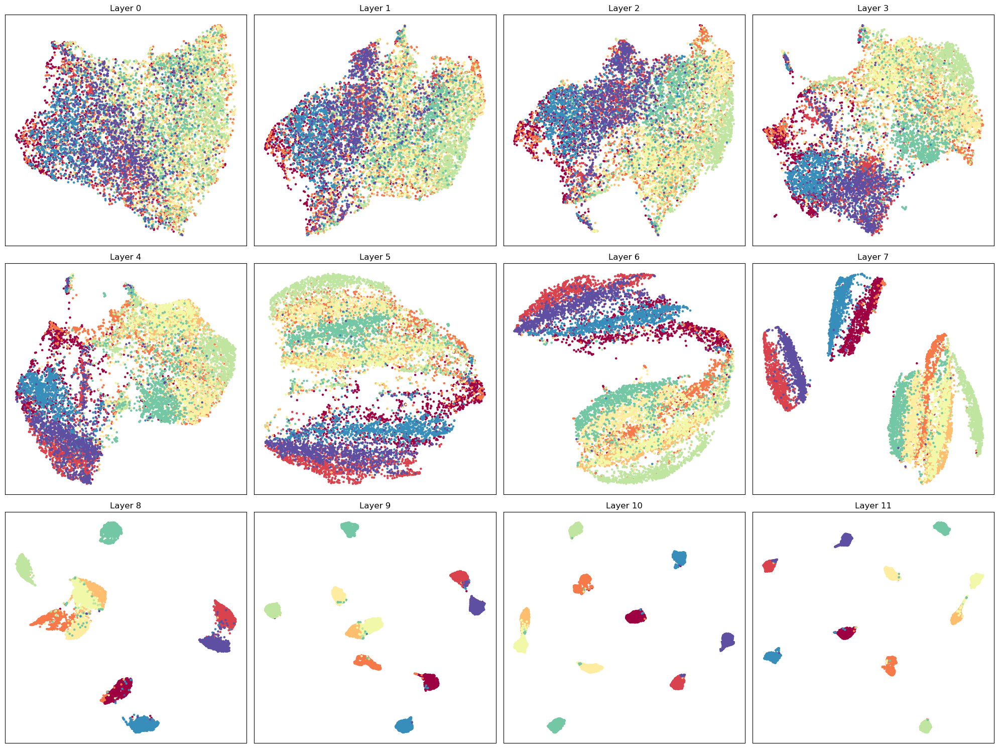

In [3]:
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(10):
            activation_path = f'activations_cifar10_vit_b/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


## for all layers

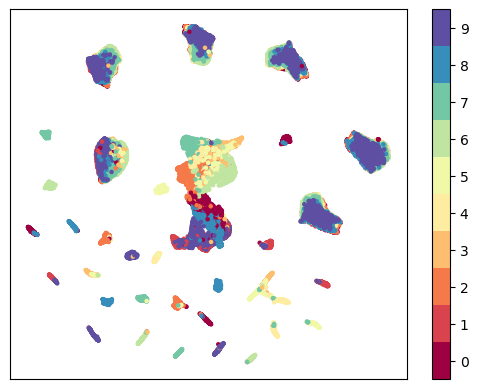

In [31]:
activations = []
labels = []

for i in range(12):
    for j in range(10):
        activation_path = f'activations_cifar10_vit_b/cifar10_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


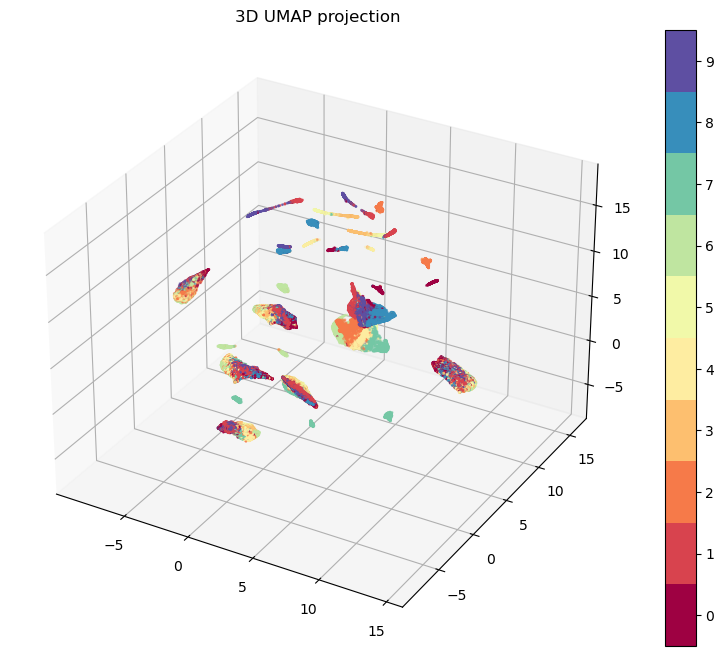

In [32]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

## for each layer

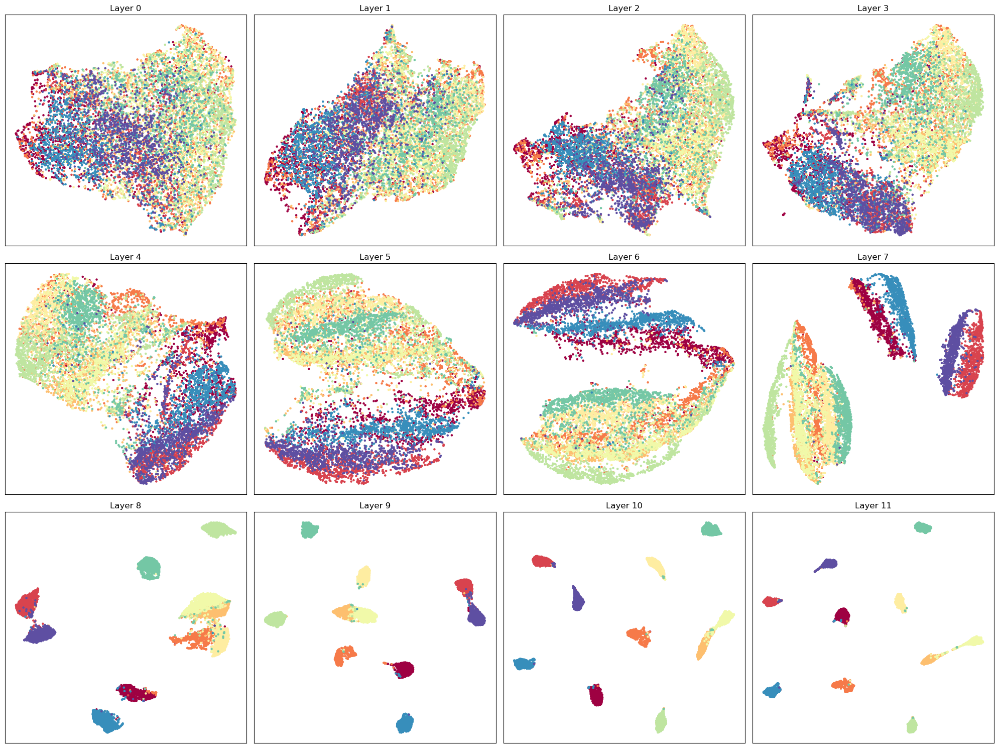

In [2]:

fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(10):
            activation_path = f'activations_cifar10_vit_b/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


## individual layers 2d, 3d

### for layer 0

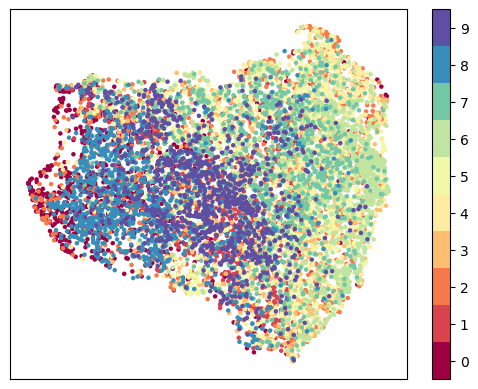

In [7]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.0.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


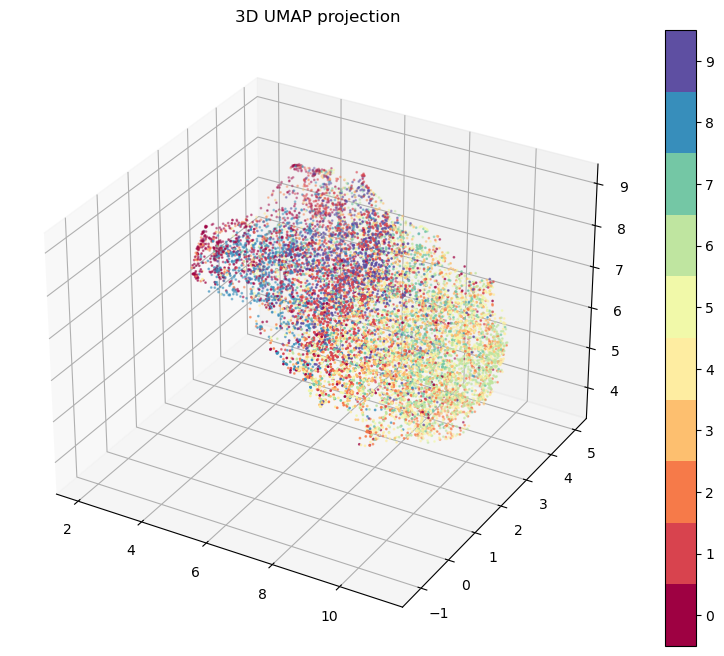

In [8]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 1

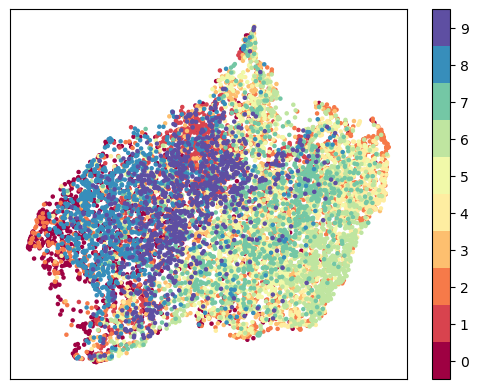

In [9]:
activations = []
labels = []


for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.1.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


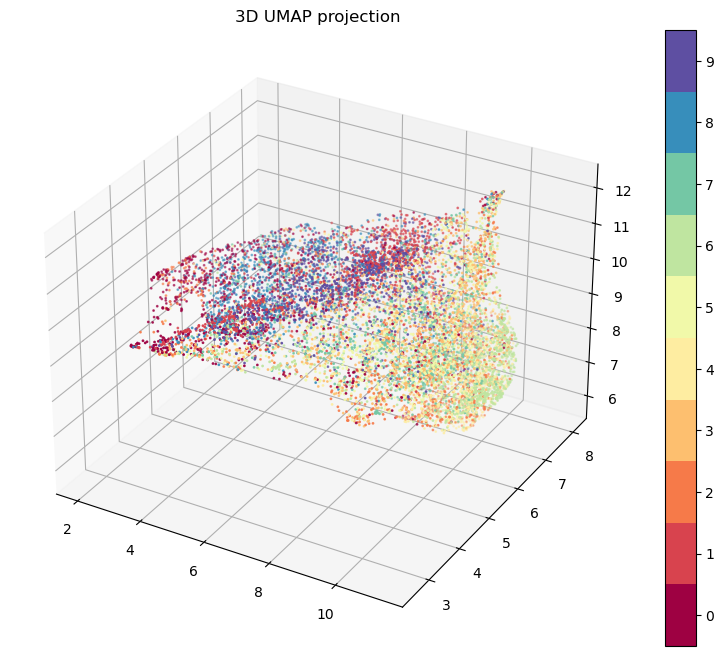

In [10]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 2

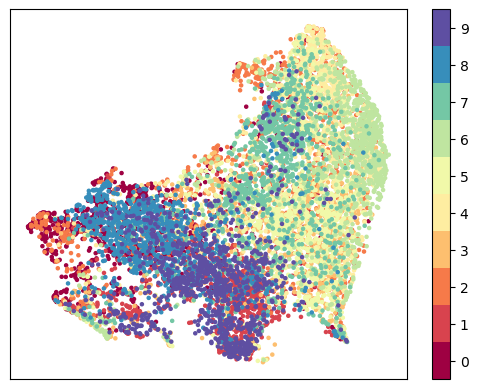

In [11]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.2.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


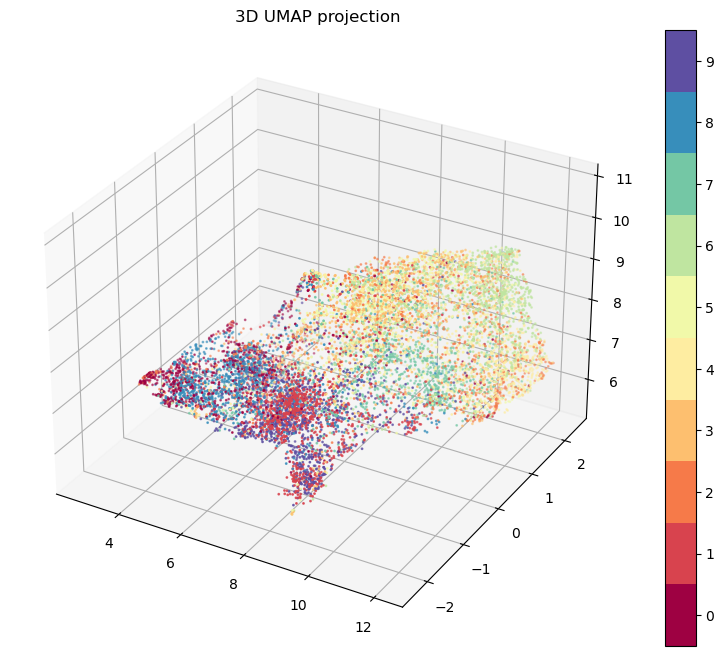

In [12]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 3

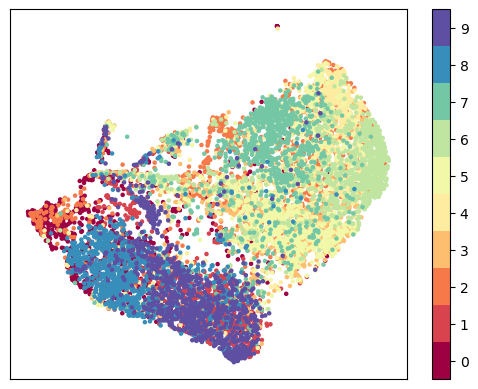

In [13]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.3.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


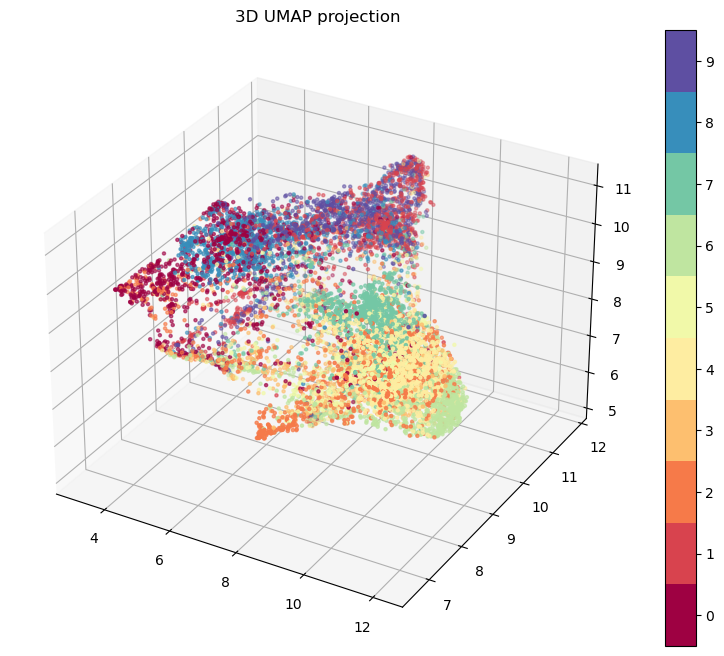

In [14]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 4

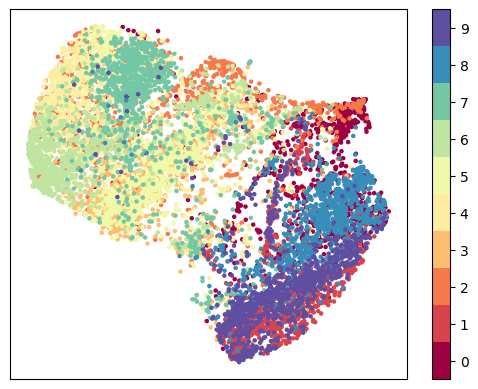

In [15]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.4.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


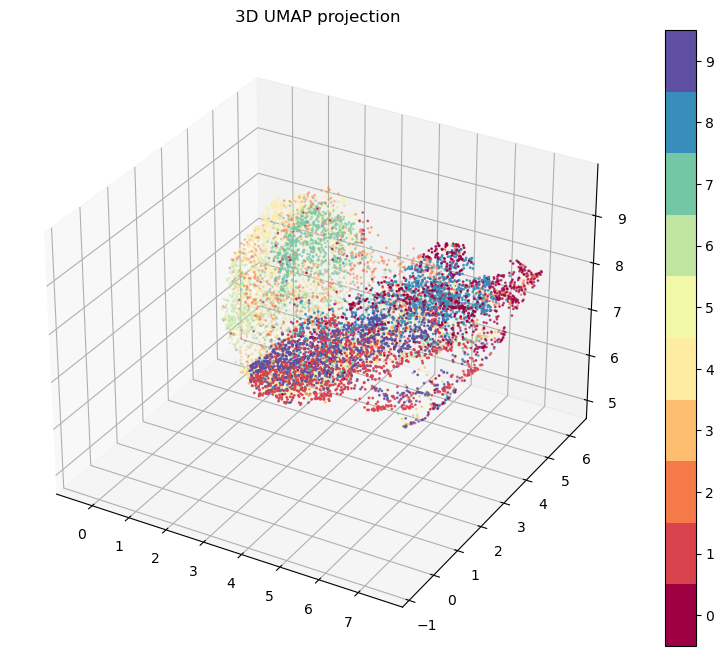

In [16]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 5

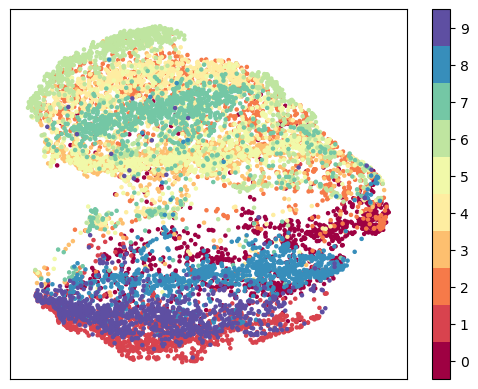

In [17]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.5.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


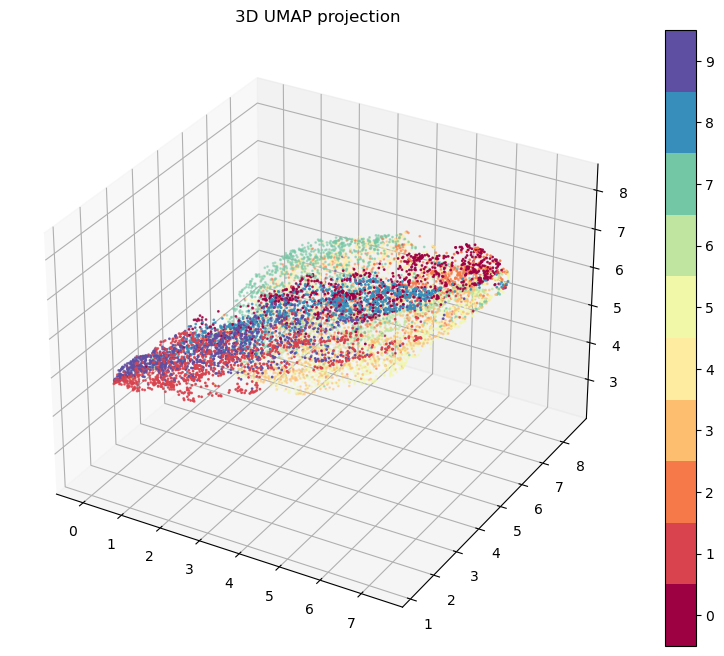

In [18]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 6

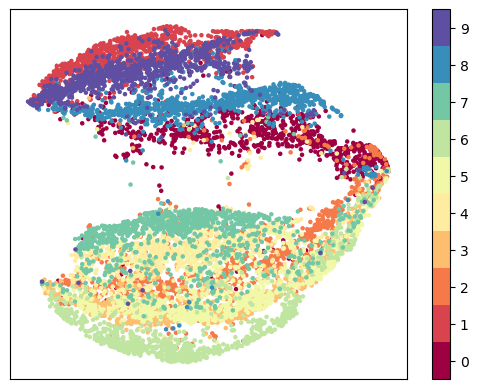

In [19]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.6.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


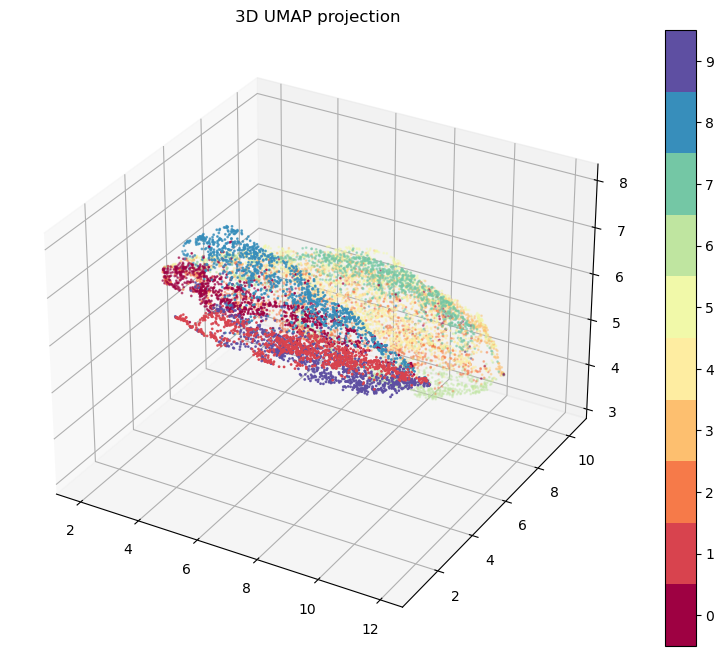

In [20]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 7

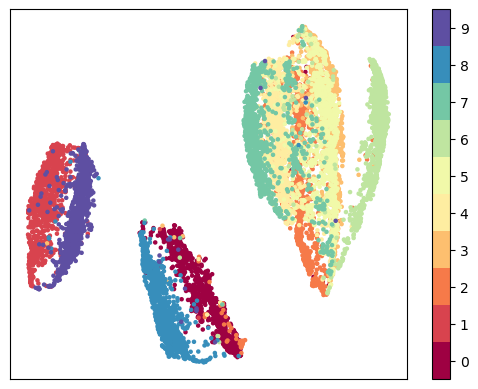

In [21]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.7.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


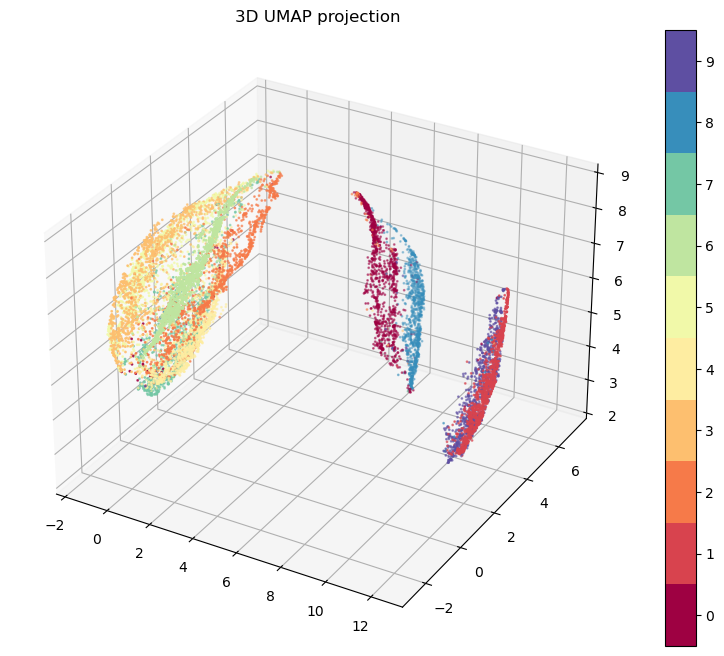

In [22]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 8

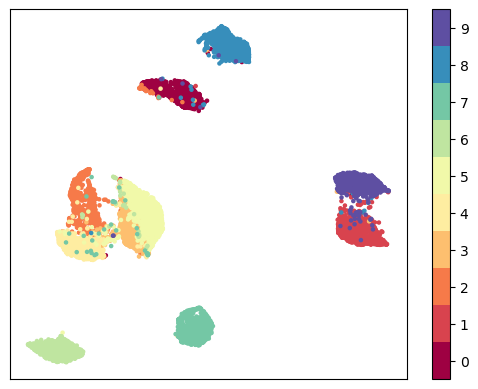

In [23]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.8.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


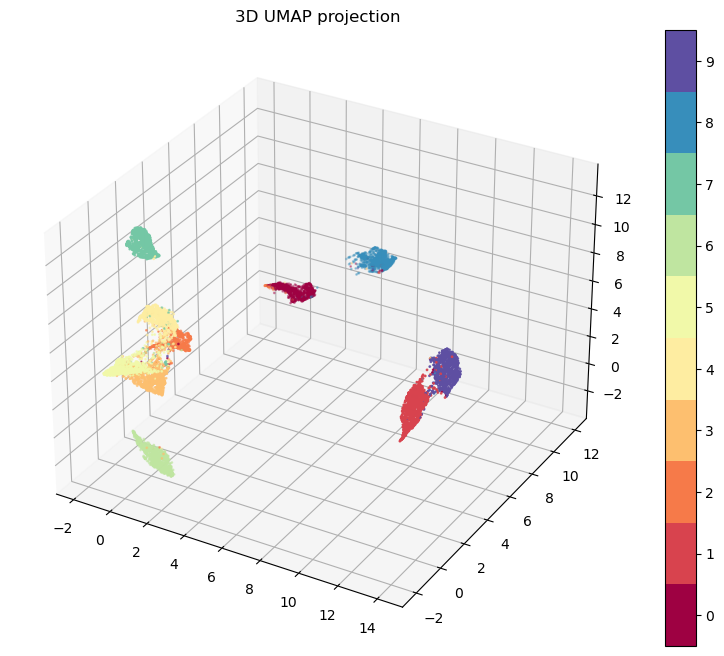

In [24]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 9

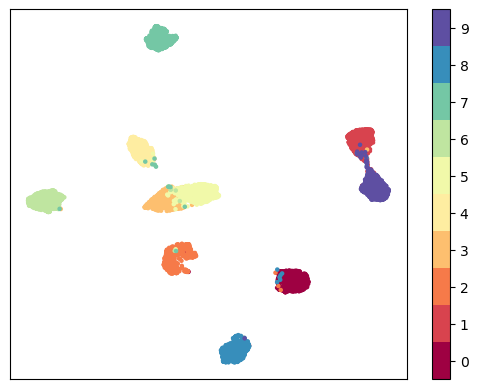

In [25]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.9.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


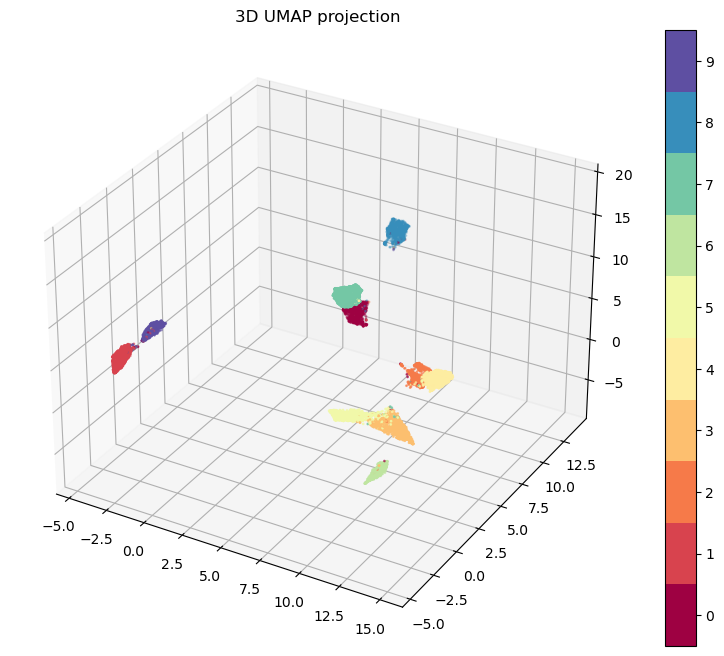

In [26]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 10

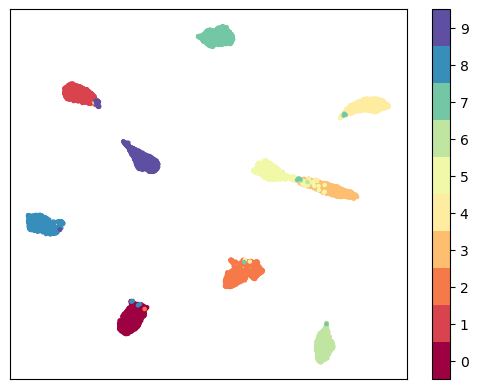

In [27]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.10.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


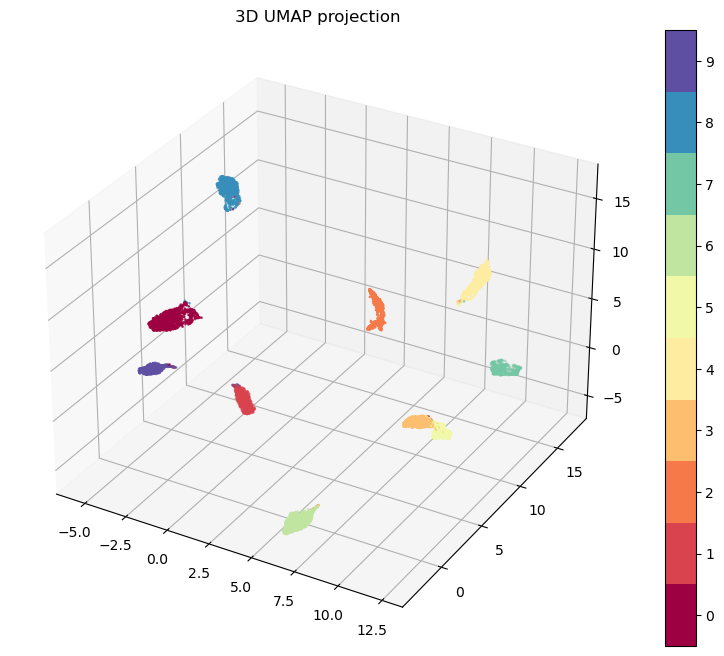

In [28]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### for layer 11

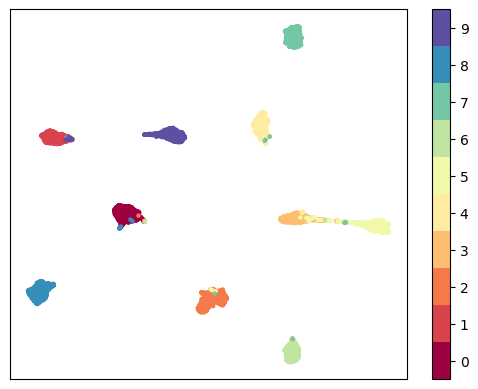

In [29]:
activations = []
labels = []



for i in range(10):
    activation_path = f'activations_cifar10_vit_b/cifar10_activations_{i}.h5'
    layer_name = f'vit.encoder.layer.11.output'
    dataset = ActivationDataset(activation_path, layer_name)
    for img, act in dataset:
        act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
        activations.append(act.mean(axis=0))
    labels.append([i]*len(dataset))
labels = np.concatenate(labels,axis=0)


reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


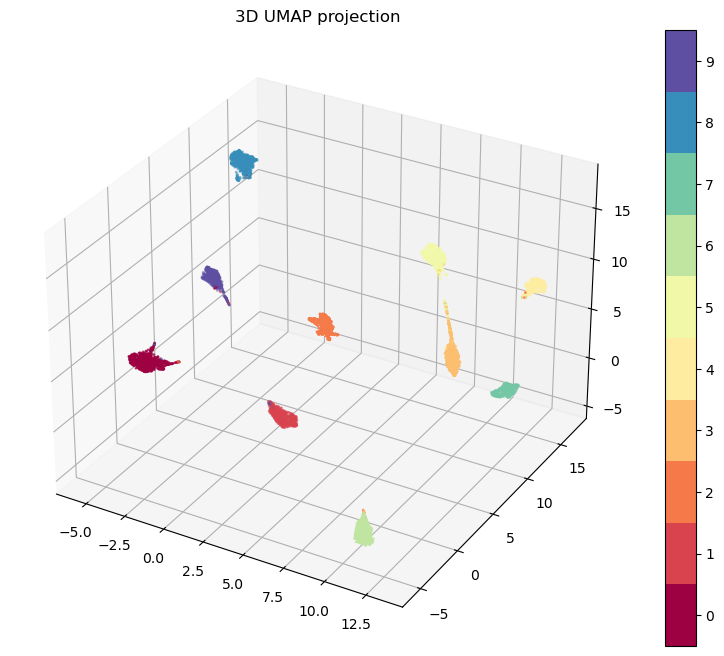

In [30]:
#3d plot

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

In [ ]:
# all layers
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(10):
            activation_path = f'activations_cifar10_vit_b/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


# catdog - all layer SAE model

In [4]:

# load trained SAE
tied_sae = TiedSAE(encoder, encoder_bias)
tied_sae.load_state_dict(torch.load('SAE_models/catdog_finetune/SAE_ratio10_epoch100_lr0.0001.pth'))
tied_sae.to_device(device)

tied_sae.encoder.requires_grad = False
tied_sae.encoder_bias.requires_grad = False

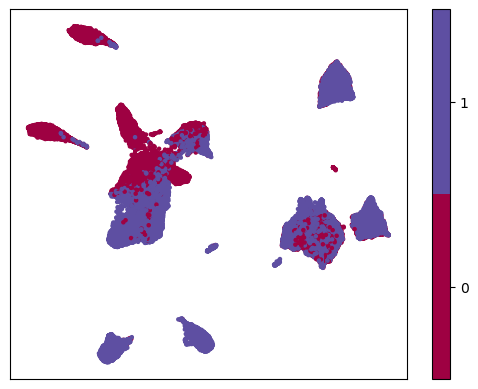

In [8]:
activations = []
labels = []

for i in range(12):
    for j in range(2):
        activation_path = f'activations_catdog_vit_b/catdog_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
plt.xticks([])
plt.yticks([])
plt.show()


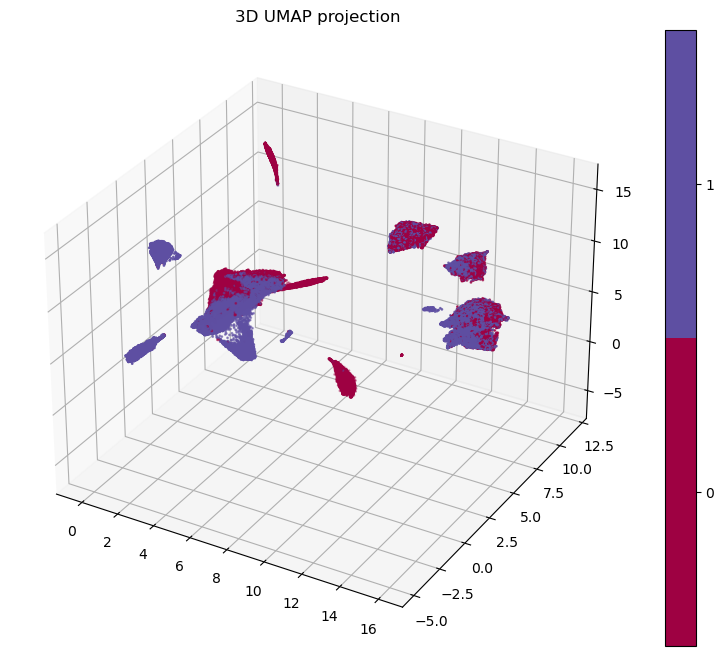

In [9]:
reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
ax.set_title('3D UMAP projection')
plt.show()

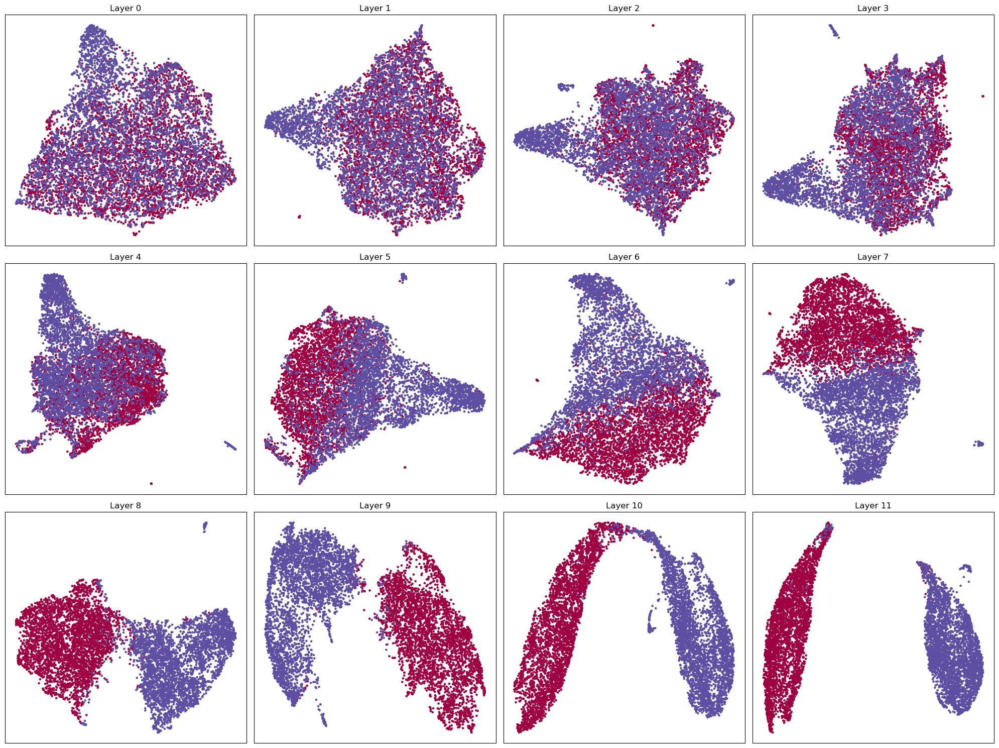

In [10]:
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(2):
            activation_path = f'activations_catdog_vit_b/catdog_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


## SAE

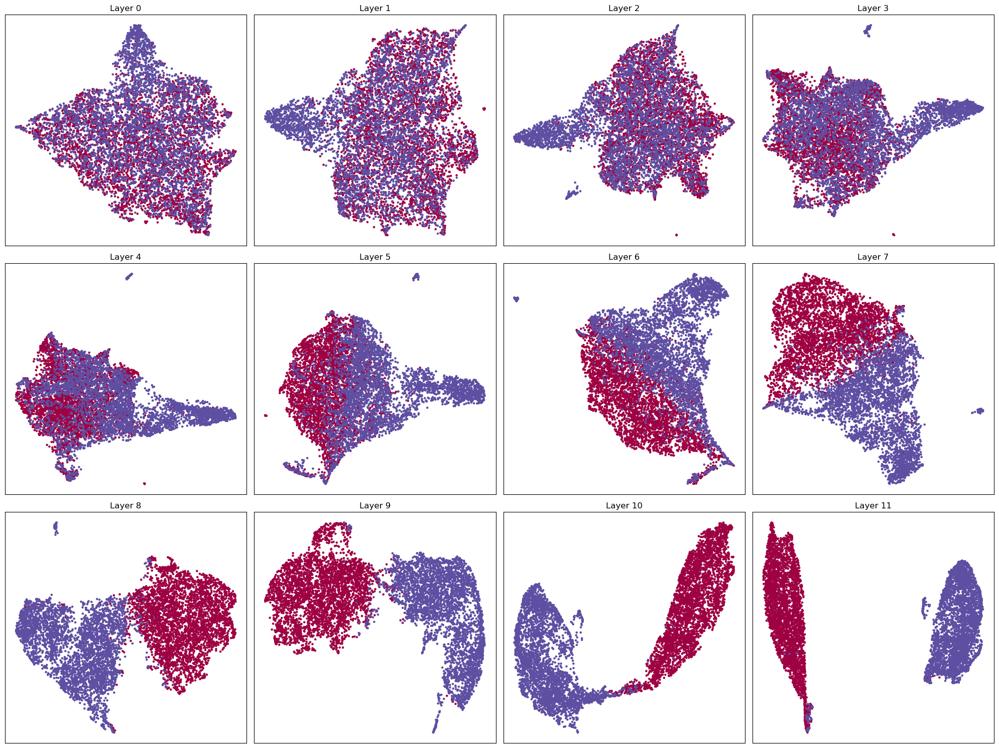

In [11]:
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(2):
            activation_path = f'activations_catdog_vit_b/catdog_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


# DINO models

## cifar10

In [2]:

# load trained SAE
tied_sae = TiedSAE(encoder, encoder_bias)
tied_sae.load_state_dict(torch.load('SAE_models/cifar10_dino/SAE_ratio10_epoch100_lr0.0001.pth'))
tied_sae.to_device(device)

tied_sae.encoder.requires_grad = False
tied_sae.encoder_bias.requires_grad = False


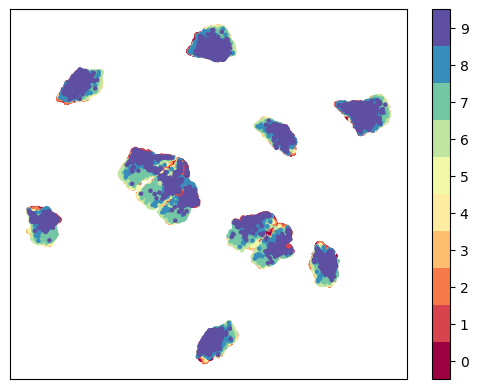

In [12]:
# original activation
activations = []
labels = []

for i in range(12):
    for j in range(10):
        activation_path = f'activations_cifar10_dino_vitb16/cifar10_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


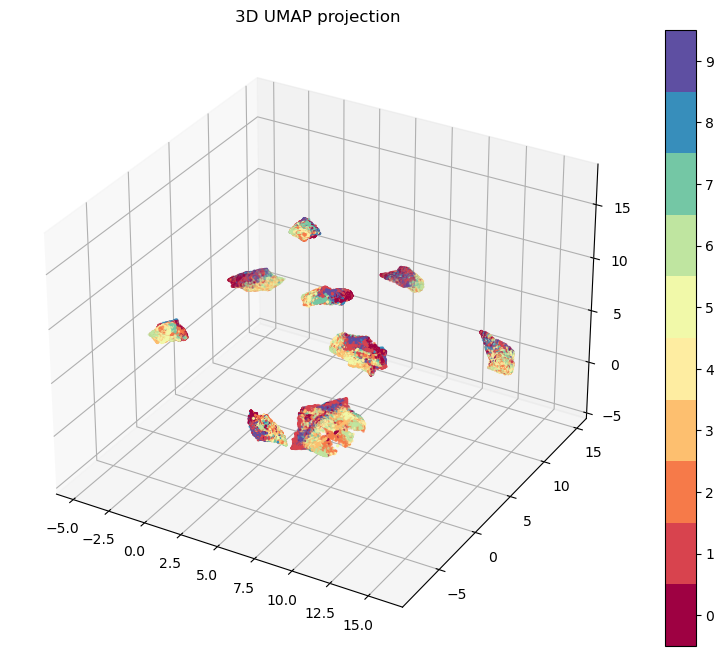

In [13]:

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

### SAE

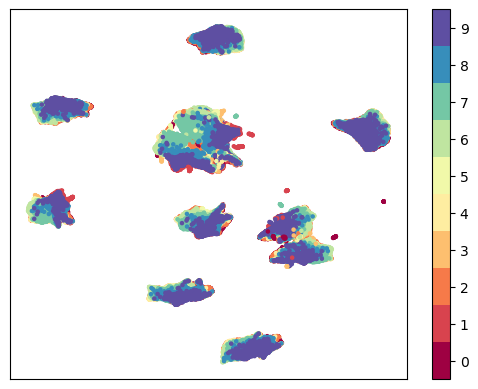

In [15]:

activations = []
labels = []

for i in range(12):
    for j in range(10):
        activation_path = f'activations_cifar10_dino_vitb16/cifar10_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.xticks([])
plt.yticks([])
plt.show()


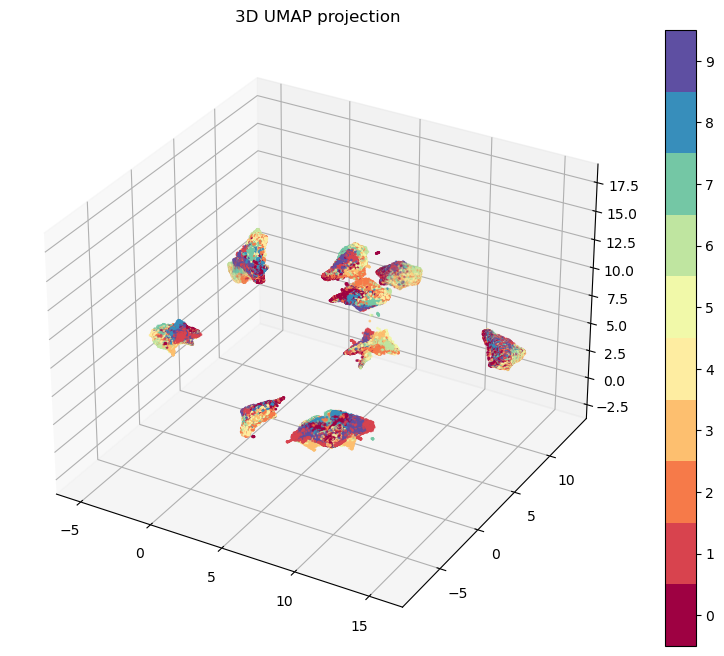

In [16]:

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
ax.set_title('3D UMAP projection')
plt.show()

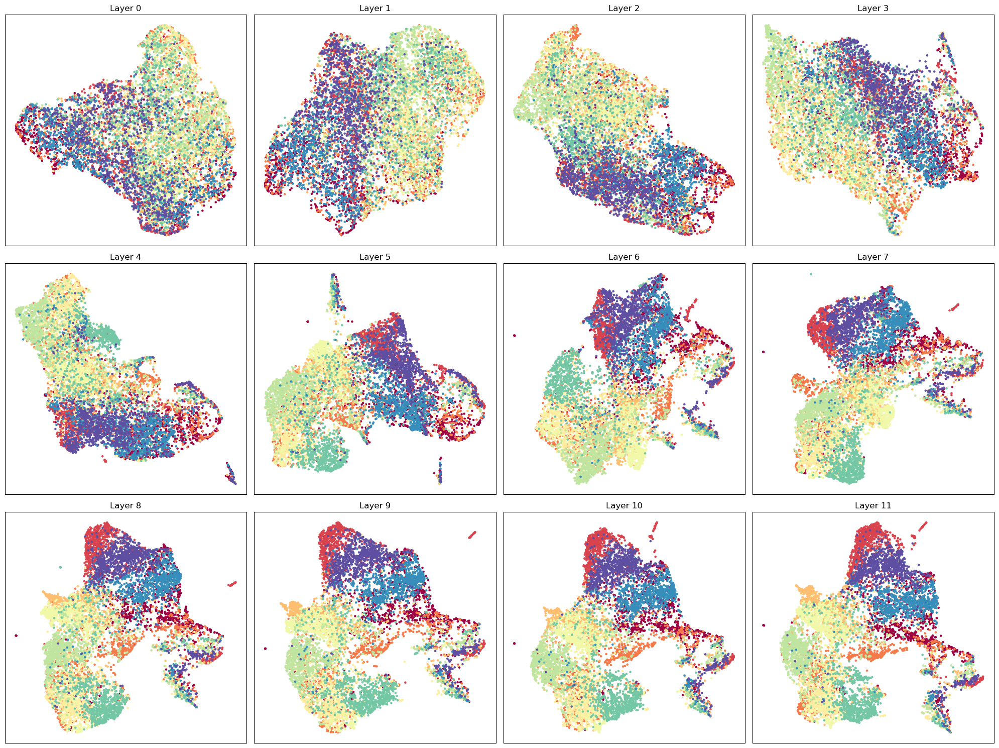

In [14]:
# 3x4 
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(10):
            activation_path = f'activations_cifar10_dino_vitb16/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


### trying different paprameters for UMAP

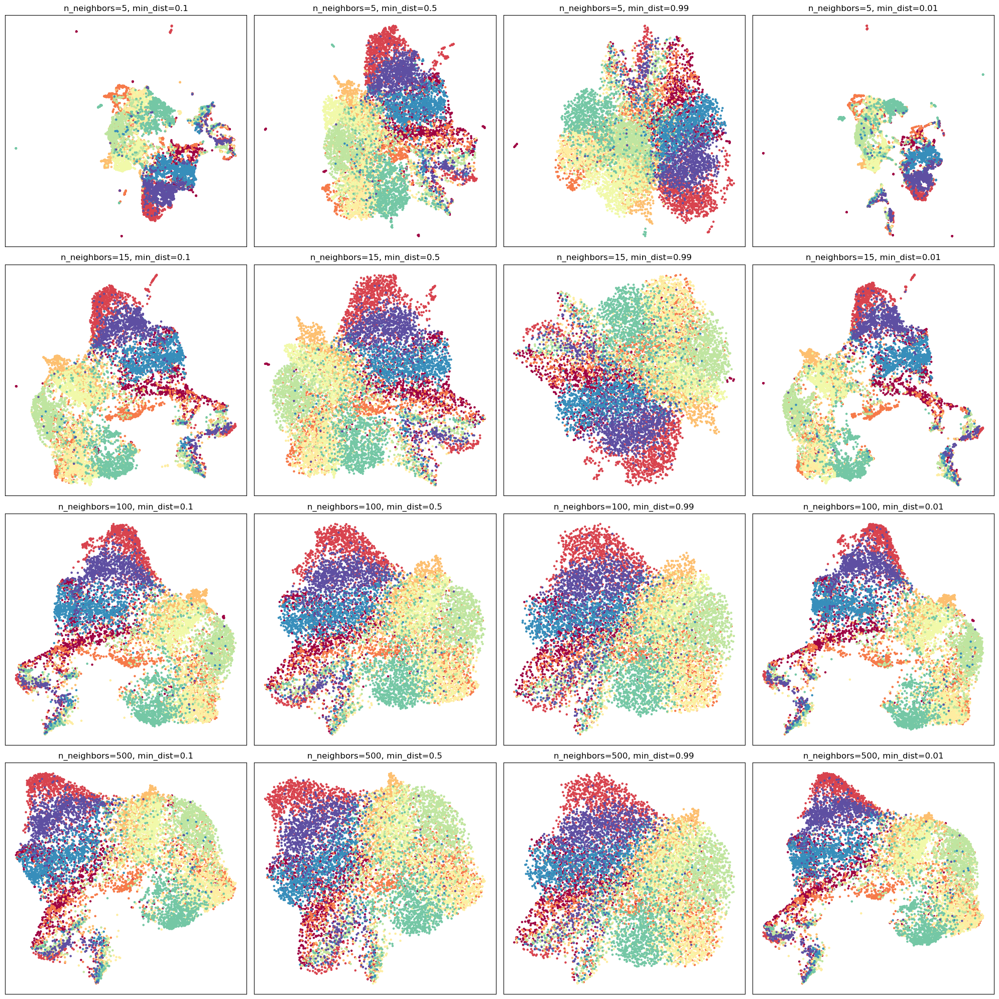

In [4]:
# different parameters
fig, axes = plt.subplots(4, 4, figsize=(20, 20))
n_neighbors = [5, 15, 100, 500]
min_dist = [0.1, 0.5, 0.99, 0.01]
for i in range(4):
    for j in range(4):
        activations = []
        labels = []
        for k in range(10):
            activation_path = f'activations_cifar10_dino_vitb16/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.11.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP(n_neighbors=n_neighbors[i], min_dist=min_dist[j])
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'n_neighbors={n_neighbors[i]}, min_dist={min_dist[j]}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


## catdog

In [7]:

# load trained SAE
tied_sae = TiedSAE(encoder, encoder_bias)
tied_sae.load_state_dict(torch.load('SAE_models/catdog_dino/SAE_ratio10_epoch100_lr0.0001.pth'))
tied_sae.to_device(device)

tied_sae.encoder.requires_grad = False
tied_sae.encoder_bias.requires_grad = False


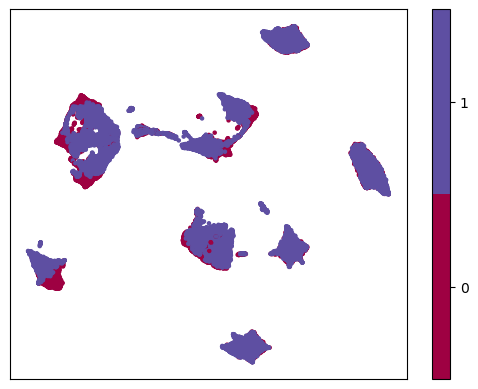

In [8]:
# original activation
activations = []
labels = []

for i in range(12):
    for j in range(2):
        activation_path = f'activations_catdog_dino_vitb16/catdog_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
plt.xticks([])
plt.yticks([])
plt.show()


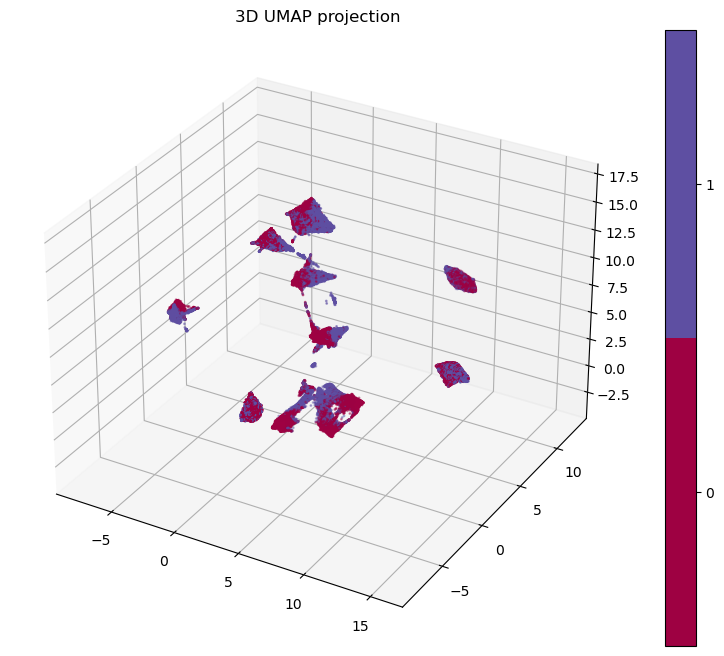

In [9]:

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
ax.set_title('3D UMAP projection')
plt.show()

### SAE activation

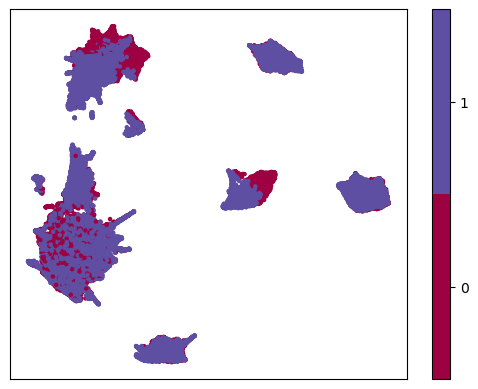

In [17]:

activations = []
labels = []

for i in range(12):
    for j in range(2):
        activation_path = f'activations_catdog_dino_vitb16/catdog_activations_{j}.h5'
        layer_name = f'vit.encoder.layer.{i}.output'
        dataset = ActivationDataset(activation_path, layer_name)
        for img, act in dataset:
            act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
            activations.append(act.mean(axis=0))
        labels.append([j]*len(dataset))
labels = np.concatenate(labels,axis=0)

reducer = umap.UMAP()
embedding = reducer.fit_transform(activations)
        
plt.figure()
scatter = plt.scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
plt.xticks([])
plt.yticks([])
plt.show()


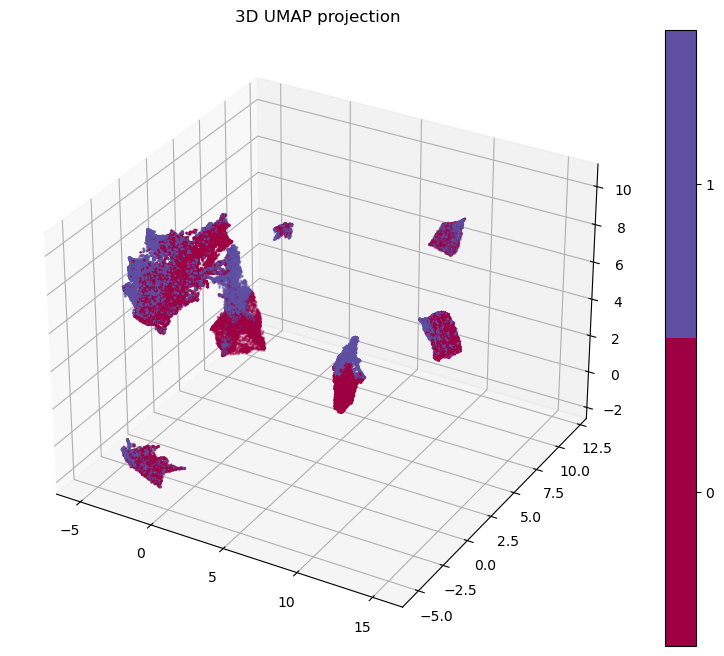

In [18]:

reducer_3d = umap.UMAP(n_components=3)
embedding_3d = reducer_3d.fit_transform(activations)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:, 2],
                     c=labels, cmap='Spectral', s=1)
plt.colorbar(scatter, boundaries=np.arange(3)-0.5).set_ticks(np.arange(2))
ax.set_title('3D UMAP projection')
plt.show()

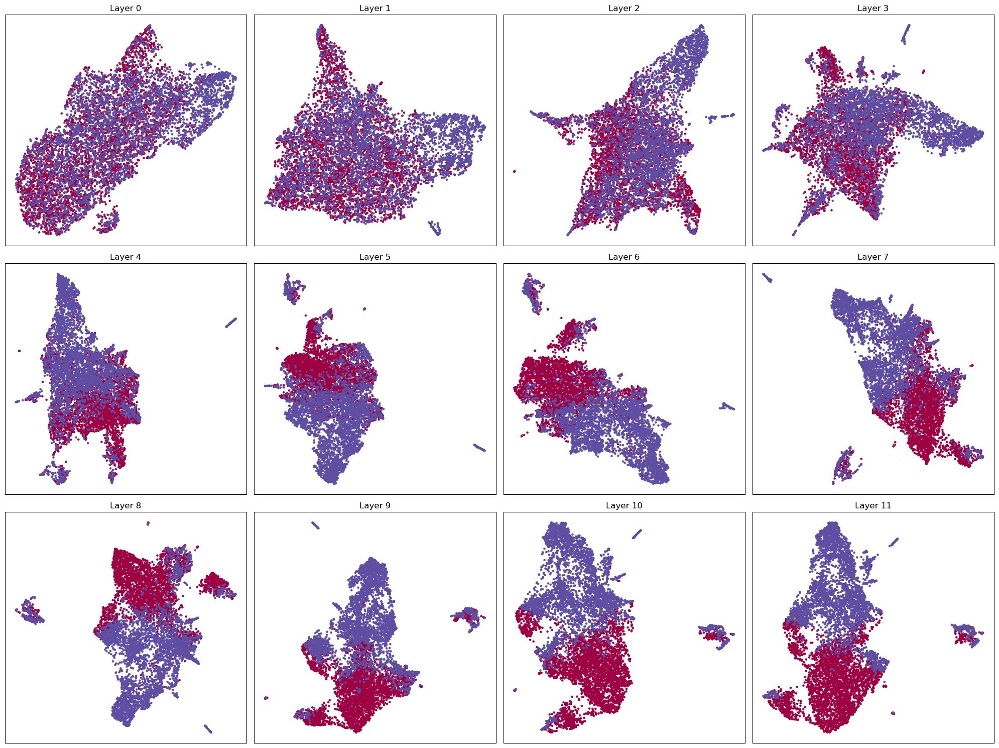

In [10]:

fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(2):
            activation_path = f'activations_catdog_vit_b/catdog_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


# ViTMAE

In [5]:

# load trained SAE
tied_sae = TiedSAE(encoder, encoder_bias)
tied_sae.load_state_dict(torch.load('SAE_models/cifar10_vitmae/SAE_ratio10_epoch100_lr0.0001.pth'))
tied_sae.to_device(device)

tied_sae.encoder.requires_grad = False
tied_sae.encoder_bias.requires_grad = False


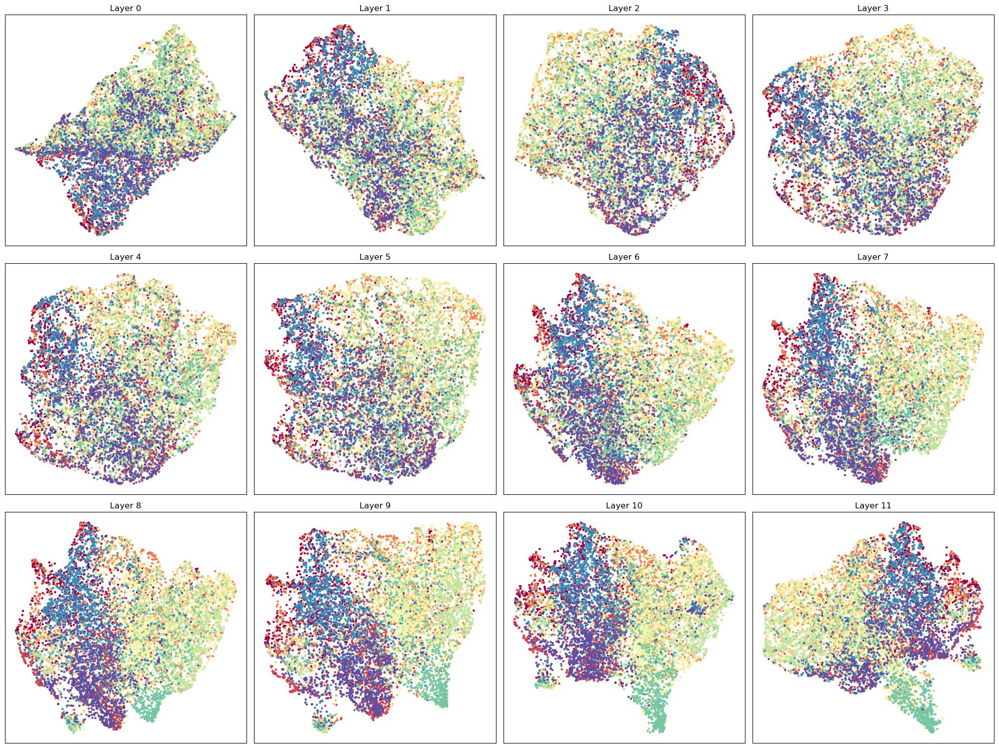

In [3]:


# all layers
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for i in range(3):
    for j in range(4):
        layer_index = i * 4 + j
        
        activations = []
        labels = []
        
        for k in range(10):
            activation_path = f'activations_cifar10_facebook_vitmae/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.{layer_index}.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'Layer {layer_index}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()


### Trying different parameters for UMAP

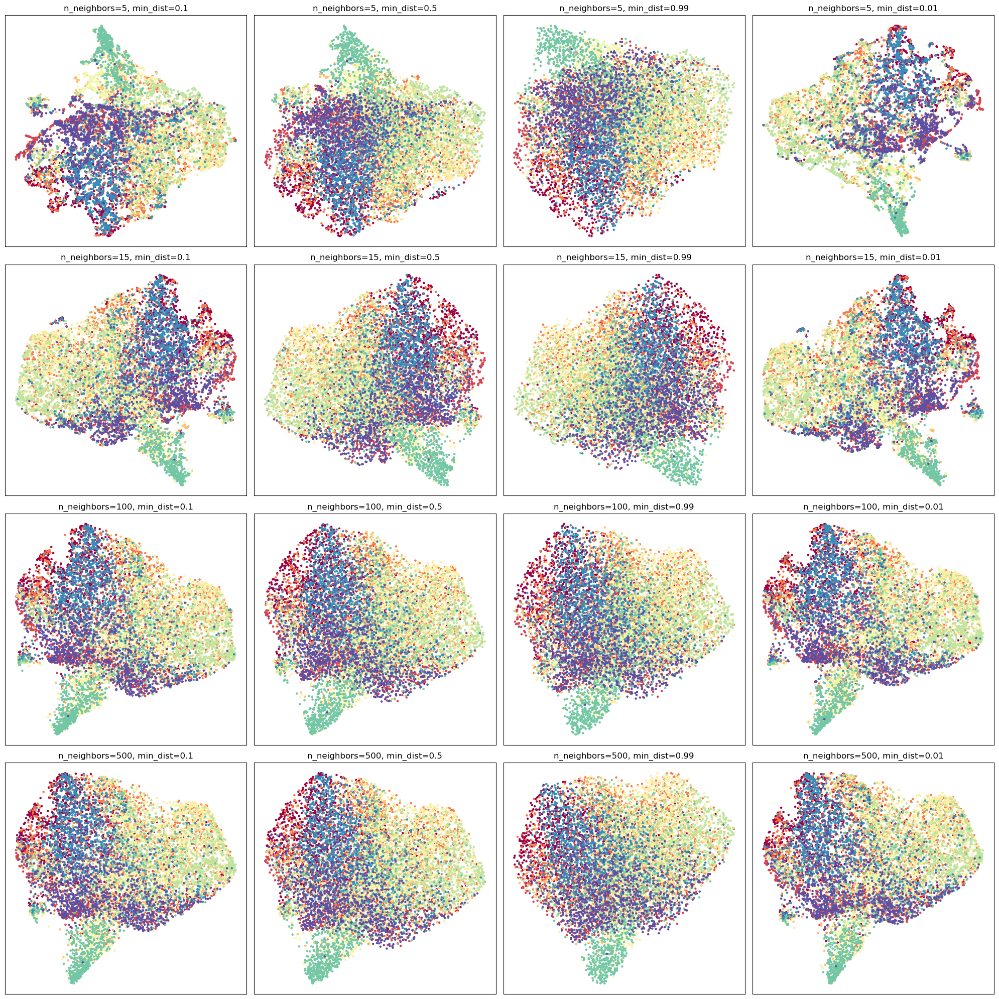

In [6]:
# different parameters
fig, axes = plt.subplots(4, 4, figsize=(20, 20))
n_neighbors = [5, 15, 100, 500]
min_dist = [0.1, 0.5, 0.99, 0.01]
for i in range(4):
    for j in range(4):
        activations = []
        labels = []
        for k in range(10):
            activation_path = f'activations_cifar10_facebook_vitmae/cifar10_activations_{k}.h5'
            layer_name = f'vit.encoder.layer.11.output'
            dataset = ActivationDataset(activation_path, layer_name)
            for img, act in dataset:
                act = tied_sae.encode(to_tensor(act).to(device)).detach().cpu().numpy().squeeze()
                activations.append(act.mean(axis=0))
            labels.append([k]*len(dataset))
        labels = np.concatenate(labels,axis=0)
        
        reducer = umap.UMAP(n_neighbors=n_neighbors[i], min_dist=min_dist[j])
        embedding = reducer.fit_transform(activations)
        
        scatter = axes[i, j].scatter(embedding[:,0], embedding[:,1], c=labels, cmap='Spectral', s=5)
        axes[i, j].set_title(f'n_neighbors={n_neighbors[i]}, min_dist={min_dist[j]}')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()
